# Object Ontology (IS-A)

We aim to find sub-type candidates for objects, and determine the
best candidate when resolving annotation ambiguity in region captions.

Given object, find sub-types which end with object name.

e.g. ball --> {snowball, baseball, soccer ball}

#### Approach

For an object (O) & associated candidate set (C), we disambiguate the sub-type,
using the Image (I) & Region (R)

e.g. I = `image`; R = `cropped bbox`; O = meter, C = {thermometer, parking meter}

--> parking meter

In [1]:
import requests
import numpy as np
from PIL import Image
from tqdm import tqdm
from utils import read_json, sort_dict

In [2]:
object2subtypes = read_json('../data/object_subtypes_o100_s10.json')

In [10]:
from models import UniCLImageText

im2txt = UniCLImageText(device='cpu',
                        obj_emb_path='../data/obj_emb.pkl',
                        img_emb_path='../data/img_emb.pkl')

In [4]:
image = 'https://encrypted-tbn0.gstatic.com/images?q=tbn:ANd9GcRKCL7IBdkCAQ0vs8GXKllQpfE7YFedtt2bGn0L6DYNz8nHii4SNbD9_PKXKpaNEBmGfqw&usqp=CAU'
image = Image.open(requests.get(image, stream=True).raw).convert('RGB')

anchor = 'ball'

candidates = list(object2subtypes[anchor])

res = im2txt.inference(image, anchor, candidates, pick_best=False)

print(res, '\n\n\n', candidates)

{'ball': 0.03266860544681549, 'basketball': 0.8960132002830505, 'orang ball': 0.04778169468045235} 


 ['ball', 'tennis ball', 'baseball', 'soccer ball', 'basketball', 'bowling ball', 'volleyball', 'meatball', 'eyeball', 'beach ball', 'baseball ball', 'disco ball', 'snowball', 'glass ball', 'golf ball', 'cotton ball', 'pool ball', 'round soccer ball', 'metal ball', 'rugby ball', 'pitcher throwing ball', 'exercise ball', 'chocolate ball', 'cement ball', 'ping pong ball', 'christmas ball', 'yoga ball', 'beach volley ball', 'rubber ball', 'roller ball', 'orang ball', 'crochet yarn ball']


## Incorporate Region-level information

We can use bounding boxes to assign unique instances of a class.
Use cropped features to select the candidate subtype.

### Two-stage approach:

#### Image-level Context for Filtering
--> Image (anchor)

#### Region-level Feature for Selection
--> Crop BBox (best)

If the bbox-dims < 224, then increase it (h,w) about the center.

<br><br><br>

### Visualize Subtype with Image BBoxes

In [5]:
regions = read_json('../VG/regions/r_1.json')
pos_tags = read_json('../VG/pos_tags/p_1.json')

In [6]:
import matplotlib.pyplot as plt
from matplotlib.patches import Rectangle
from img2color import get_img_id_to_path
from models import POSTagger
from inflect import engine

id2paths = get_img_id_to_path('../VG')
tagger = POSTagger()
inflect = engine()


def _get_obj_names(sent):
    def _singular(_word: str) -> str:
        out = inflect.singular_noun(_word)
        return out if out else _word

    def _clean(s: str):
        s = s.replace('.', '')
        s = s.replace("'s", '')
        s = s.replace("`s", '')
        s = s.replace('"', '')
        s = s.replace("\\", '')
        s = s.replace('/', '')
        s = s.replace(',', '')
        return s

    _objs = []
    prev_tag = ''
    for word, tag in sent.items():
        # If word is Noun
        if 'NN' in tag:
            # clean
            word = _clean(word)

            # skip noise
            if len(word) < 2:
                continue

            # plural
            word = _singular(word) if tag == 'NNS' else word

            # consecutive NNs
            if 'NN' in prev_tag:
                # retrieve the last word
                last = _objs[-1]
                word = last + ' ' + word
                # remove last word
                _objs = _objs[:-1]

            # append new word
            _objs += [word]

        # Update previous tag
        prev_tag = tag

    return _objs


def _annotate(ax, box: list, label: str, color='red'):
    x, y, w, h = box
    # text
    ax.text(x, y - 5, label, fontsize=12, color='black', bbox={'facecolor': 'white', 'alpha': 0.4})
    # bbox
    rect = Rectangle((x, y), w, h, edgecolor=color, facecolor='none')
    ax.add_patch(rect)


def plot_img_from_region(d: dict, pos=False, subs=False, num=10):
    im_path = id2paths[d['image_id']]

    img = Image.open(im_path).convert('RGB')
    im_w, im_h = img.size

    plt.figure(figsize=(14, 14))
    plt.imshow(img)

    # reference
    axes = plt.gca()

    for r in d['regions'][:num]:
        text = r['phrase'].lower()
        bbox = [r['x'], r['y'], r['width'], r['height']]

        if pos:
            text = _get_obj_names(tagger(text))
            bbox = _extend_bbox(bbox, im_w, im_h, size=224)
            if subs:
                for obj in text:
                    subtypes = object2subtypes.get(obj, None)
                    if subtypes:
                        subtypes = list(subtypes)
                        selected = im2txt.inference(img, obj, subtypes)
                        print(selected)
                        crop = _crop(img, bbox)
                        best = im2txt.inference(crop, obj, list(selected), pick_best=True)
                        print(best)
            else:
                text = ', '.join(text)

        _annotate(axes, bbox, text)

    plt.show()


def _crop(im, box):
    x, y, w, h = box

    left, top = x, y
    right, down = x+w, y+h

    return im.crop((left, top, right, down))


def _extend_bbox(box, im_w, im_h, size=224):
    # unpack
    x, y, w, h = box

    # increase size
    if w < size:
        x = x - (size - w)/2
        w = size

    if h < size:
        y = y - (size - h)/2
        h = size

    # clip to img dims
    x = np.clip(x, 0, im_w)
    w = np.clip(w, 0, im_w)
    y = np.clip(y, 0, im_h)
    h = np.clip(h, 0, im_h)

    # pack
    box = [x, y, w, h]

    return box

2022-06-19 14:08:46,938 loading file /home/axe/.flair/models/pos-english/a9a73f6cd878edce8a0fa518db76f441f1cc49c2525b2b4557af278ec2f0659e.121306ea62993d04cd1978398b68396931a39eb47754c8a06a87f325ea70ac63
2022-06-19 14:08:48,513 SequenceTagger predicts: Dictionary with 53 tags: <unk>, O, UH, ,, VBD, PRP, VB, PRP$, NN, RB, ., DT, JJ, VBP, VBG, IN, CD, NNS, NNP, WRB, VBZ, WDT, CC, TO, MD, VBN, WP, :, RP, EX, JJR, FW, XX, HYPH, POS, RBR, JJS, PDT, NNPS, RBS, AFX, WP$, -LRB-, -RRB-, ``, '', LS, $, SYM, ADD


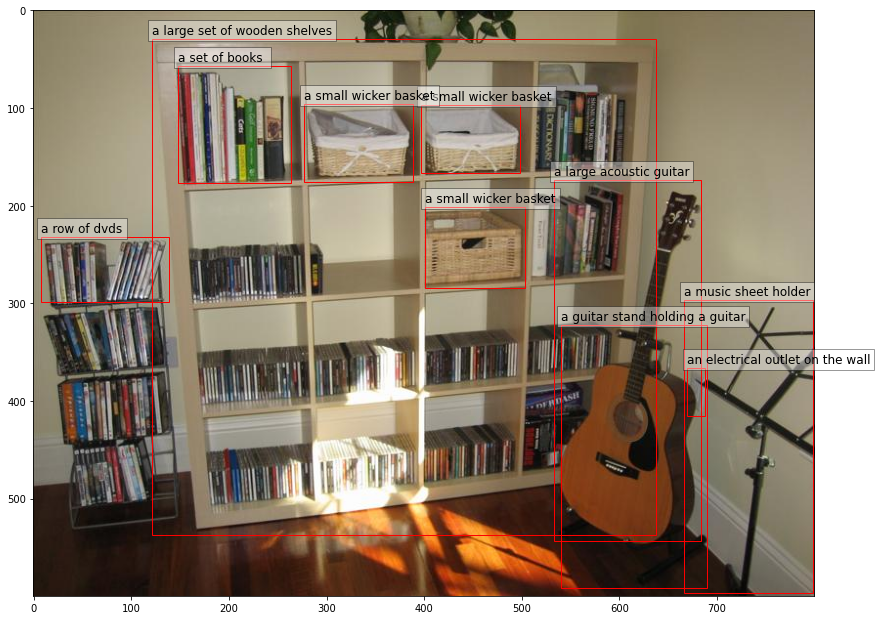

{'guitar': 1.0}
{'guitar': 1.0}
{'outlet': 0.056914977729320526, 'wall outlet': 0.3008408546447754, 'power outlet': 0.14969195425510406, 'window outlet': 0.4558992385864258}
{'window outlet': 0.5266352891921997}
{'wall': 0.01131563913077116, 'kitchen wall': 0.012880440801382065, 'wood wall': 0.01678350567817688, 'bedroom wall': 0.04406553879380226, 'block wall': 0.014247970655560493, 'room wall': 0.16762863099575043, 'store wall': 0.017853515222668648, 'divider wall': 0.19249184429645538, 'accent wall': 0.024957651272416115, 'panel wall': 0.022833511233329773, 'office wall': 0.023332633078098297, 'privacy wall': 0.11675665527582169, 'partition wall': 0.05253488942980766, 'living room wall': 0.10625513643026352, 'tennis wall': 0.03520828112959862, 'plank wall': 0.011574827134609222}
{'room wall': 0.18429520726203918}
{'wicker basket': 1.0}
{'wicker basket': 1.0}
{'wicker basket': 1.0}
{'wicker basket': 1.0}
{'wicker basket': 1.0}
{'wicker basket': 1.0}
{'set': 0.14394909143447876, 'tv s

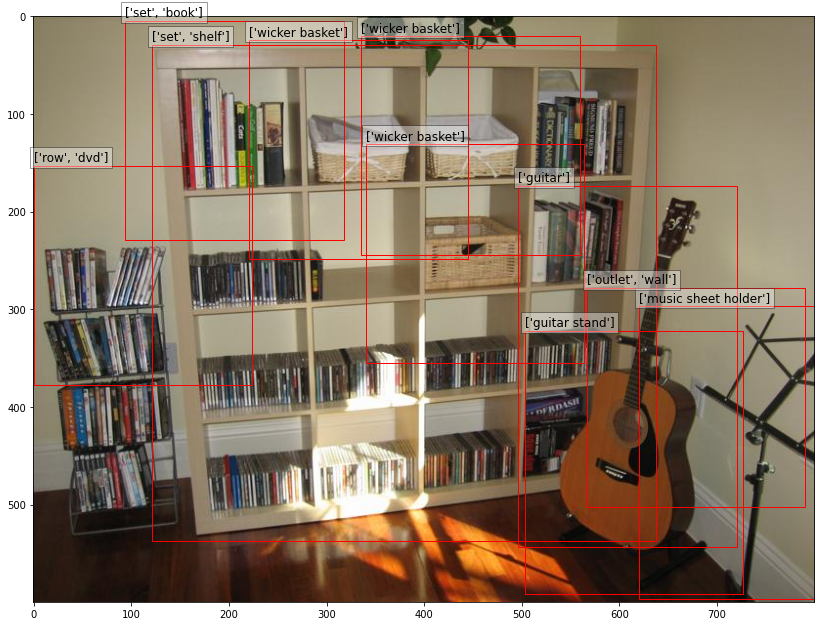

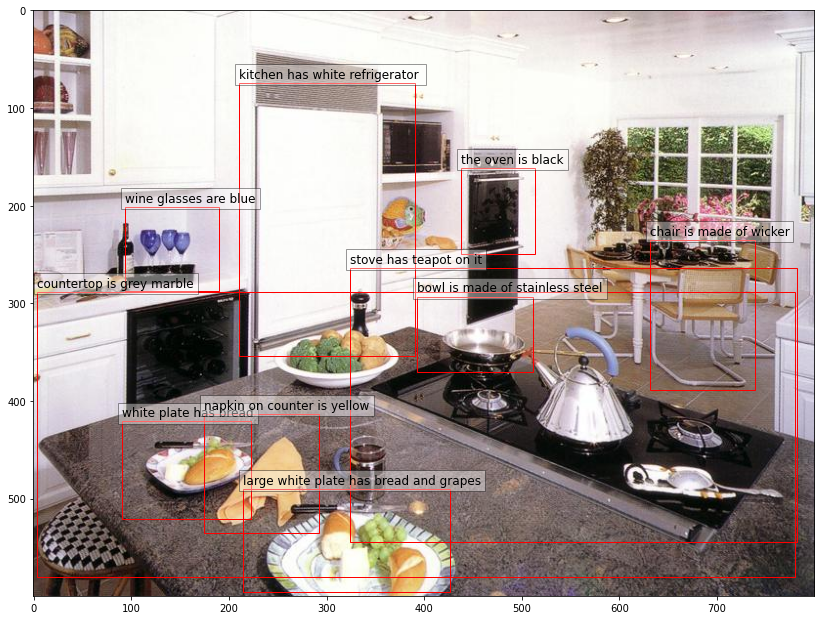

{'kitchen': 0.3711288571357727, 'toy kitchen': 0.5632376670837402}
{'toy kitchen': 0.9293924570083618}
{'refrigerator': 0.24993771314620972, 'steel refrigerator': 0.3343012034893036}
{'refrigerator': 0.6833745241165161}
{'countertop': 0.12470311671495438, 'granite countertop': 0.1279730200767517, 'kitchen countertop': 0.3390144109725952}
{'kitchen countertop': 0.44418033957481384}
{'marble': 0.8021577000617981}
{'marble': 1.0}
{'plate': 0.011693106964230537, 'glass plate': 0.01632741466164589, 'styrofoam plate': 0.0763256847858429, 'table plate': 0.02656945399940014, 'base plate': 0.013101468794047832, 'wall plate': 0.02963751181960106, 'food plate': 0.01747841387987137, 'breakfast plate': 0.02342410571873188, 'steel plate': 0.057174839079380035, 'edge plate': 0.07022297382354736, 'lunch plate': 0.014059536159038544, 'face plate': 0.0122064845636487, 'saucer plate': 0.013178032822906971, 'rectangle plate': 0.01966821402311325, 'foam plate': 0.11576618999242783, 'outlet plate': 0.222052

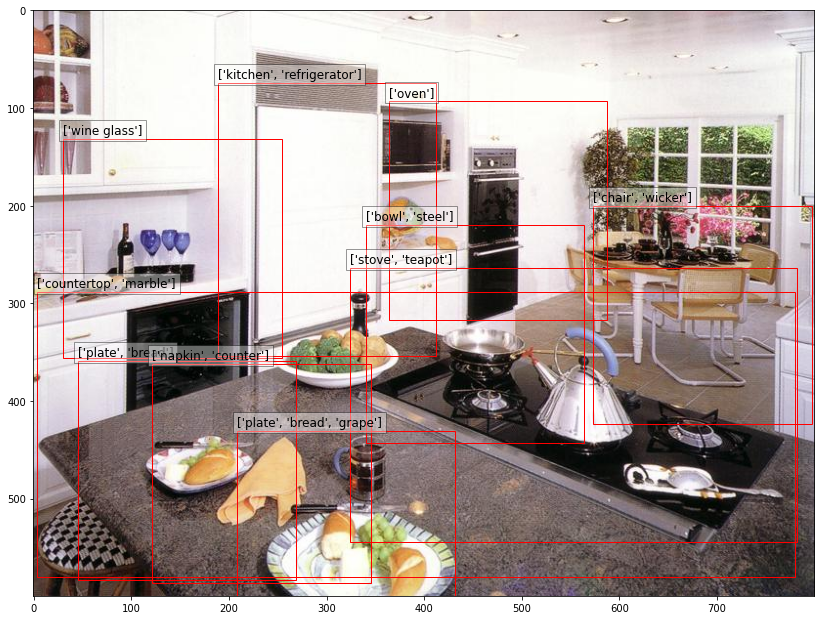

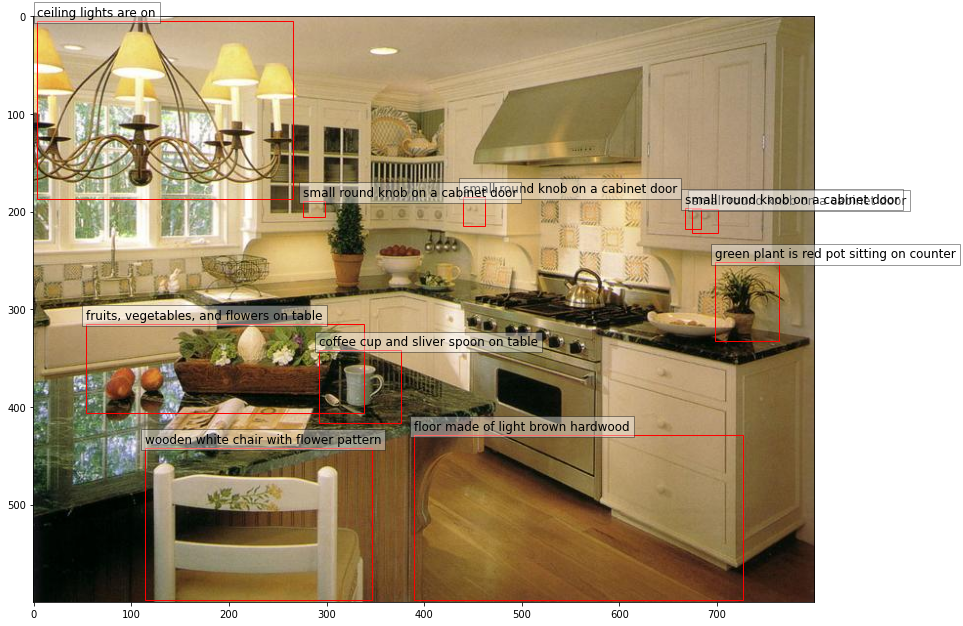

{'plant': 0.12865594029426575, 'house plant': 0.4475753605365753, 'pot plant': 0.14881926774978638}
{'pot plant': 0.5916773080825806}
{'pot': 0.038444776087999344, 'teapot': 0.04536745324730873, 'coffee pot': 0.052136607468128204, 'metal pot': 0.04149883985519409, 'cooking pot': 0.039254169911146164, 'copper pot': 0.15891921520233154, 'steel pot': 0.3360574543476105, 'terra cotta pot': 0.03897031769156456, 'cast iron pot': 0.08305346965789795}
{'terra cotta pot': 0.5206298828125}
{'counter': 0.03772701695561409, 'kitchen counter': 0.14022929966449738, 'sink counter': 0.038062822073698044, 'granite counter': 0.1473727822303772, 'wood counter': 0.039744555950164795, 'tile counter': 0.1118515208363533, 'steel counter': 0.04035462066531181, 'stone counter': 0.0646534413099289, 'island counter': 0.2193780094385147, 'granite kitchen counter': 0.0785498097538948}
{'granite counter': 0.4089747965335846}
{'coffee cup': 1.0}
{'coffee cup': 1.0}
{'table': 0.009366348385810852, 'dining table': 0.0

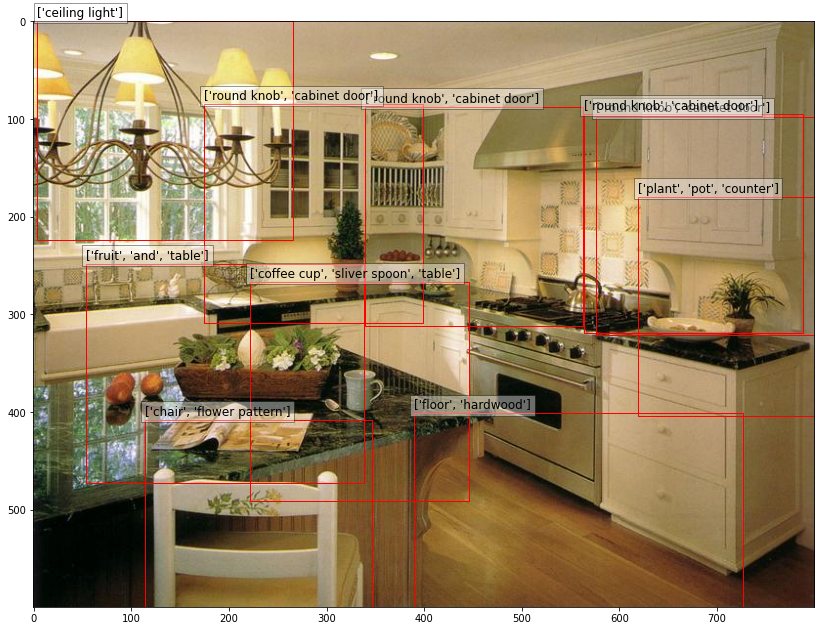

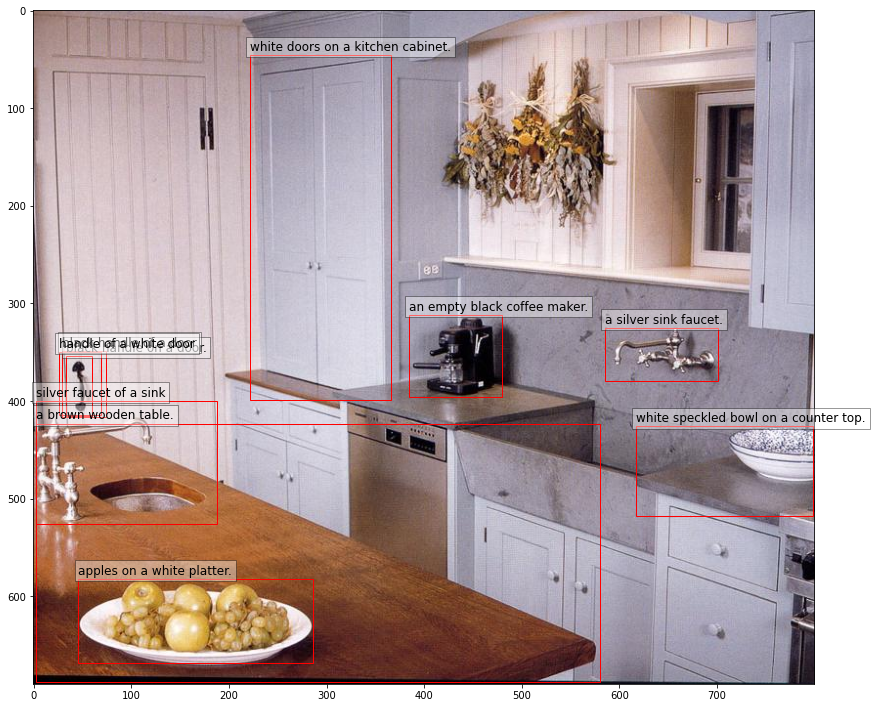

{'table': 0.003324883757159114, 'wood table': 0.0036762207746505737, 'dining table': 0.00831520278006792, 'kitchen table': 0.19451074302196503, 'dining room table': 0.011927993968129158, 'metal table': 0.004170358180999756, 'marble table': 0.004987687338143587, 'wood grain table': 0.006652504205703735, 'dinning table': 0.008724984712898731, 'steel table': 0.022180261090397835, 'stone table': 0.0057670664973556995, 'breakfast table': 0.005377937573939562, 'iron table': 0.010239223949611187, 'oak table': 0.022414013743400574, 'surface table': 0.0193669181317091, 'wood kitchen table': 0.13453425467014313, 'granite table': 0.24326437711715698, 'tile table': 0.006543997675180435, 'produce table': 0.046467993408441544, 'butcher block table': 0.2078317105770111}
{'wood kitchen table': 0.7405509352684021}
{'apple': 0.315211683511734, 'gala apple': 0.40516307950019836}
{'gala apple': 0.8145335912704468}
{'platter': 0.1559453308582306, 'fruit platter': 0.17467381060123444, 'metal platter': 0.515

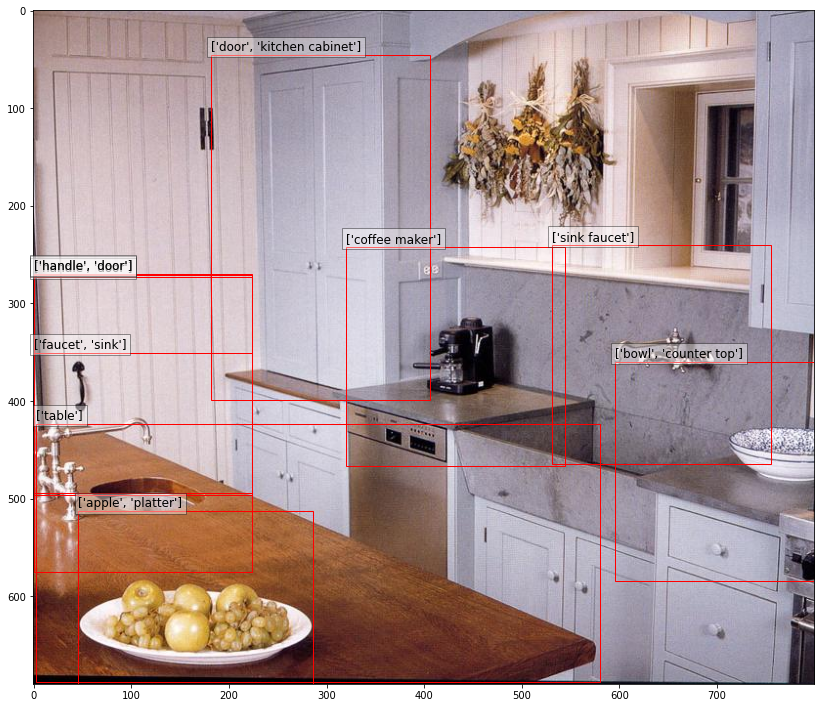

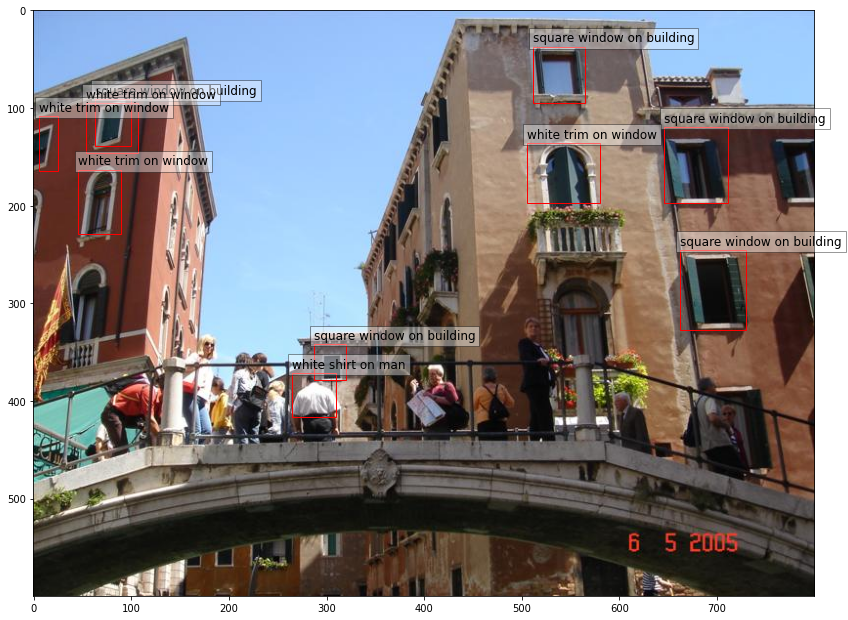

{'window': 0.014616725035011768, 'bus window': 0.019063912332057953, 'building window': 0.015906650573015213, 'floor window': 0.05650513991713524, 'story window': 0.04186881333589554, 'view window': 0.022194812074303627, 'boat window': 0.056916553527116776, 'restaurant window': 0.017856089398264885, 'level window': 0.04142410680651665, 'apartment window': 0.2776629328727722, 'ticket window': 0.05070249363780022, 'balcony window': 0.12235399335622787, 'row window': 0.04982910305261612, 'archway window': 0.017631640657782555}
{'story window': 0.17073769867420197}
{'building': 0.019937796518206596, 'brick building': 0.03434399515390396, 'stone building': 0.03049527294933796, 'apartment building': 0.12914501130580902, 'city building': 0.033693887293338776, 'story building': 0.020055709406733513, 'brick apartment building': 0.02005167491734028, 'hotel building': 0.022141944617033005, 'window building': 0.06255964934825897, 'level building': 0.07283920794725418, 'age building': 0.01996546238

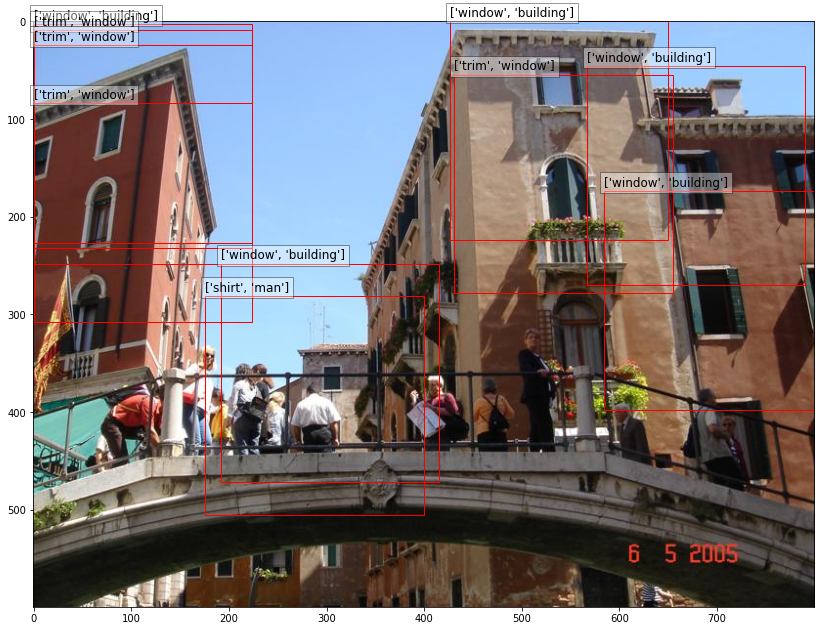

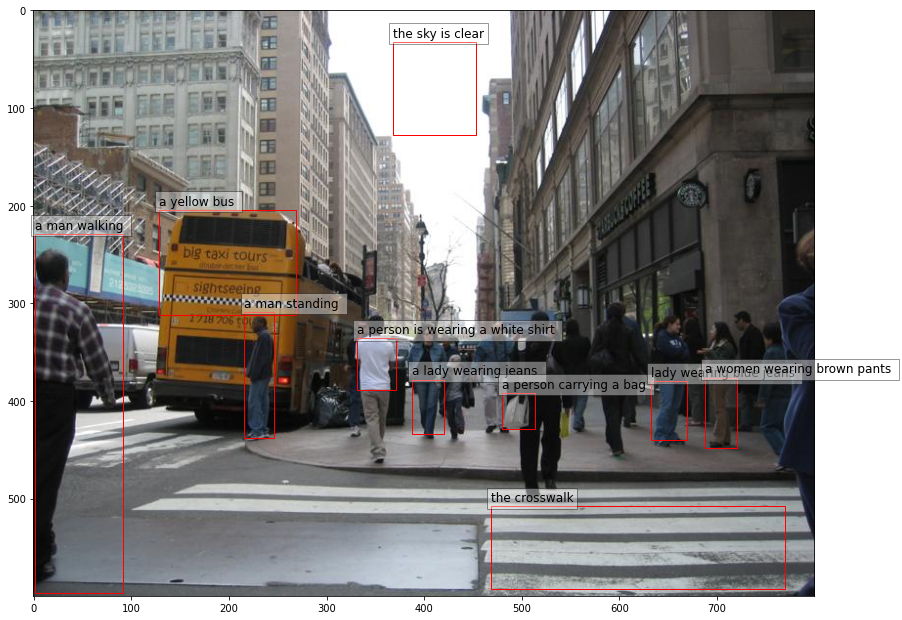

{'bus': 0.030083470046520233, 'city bus': 0.07673003524541855, 'tour bus': 0.030420266091823578, 'transit bus': 0.049723342061042786, 'shuttle bus': 0.04873929172754288, 'metro bus': 0.03460882604122162, 'decker tour bus': 0.08197227120399475, 'street bus': 0.1785494089126587, 'city transit bus': 0.04708254337310791, 'decker city bus': 0.10633483529090881, 'trolley bus': 0.05099928751587868}
{'decker city bus': 0.2443087249994278}
{'crosswalk': 0.33697718381881714, 'street crosswalk': 0.3454859256744385}
{'crosswalk': 0.5754356384277344}
{'person': 0.0062266383320093155, 'group person': 0.00930203590542078, 'umbrella person': 0.0206203144043684, 'bench person': 0.023247098550200462, 'camera person': 0.05145267769694328, 'sidewalk person': 0.8499482870101929, 'skateboard person': 0.009323911741375923}
{'sidewalk person': 0.902346670627594}
{'shirt': 0.0293352622538805, 'plaid shirt': 0.03435564786195755, 'nike shirt': 0.38669058680534363, 'denim shirt': 0.04291708767414093, 'khaki shirt

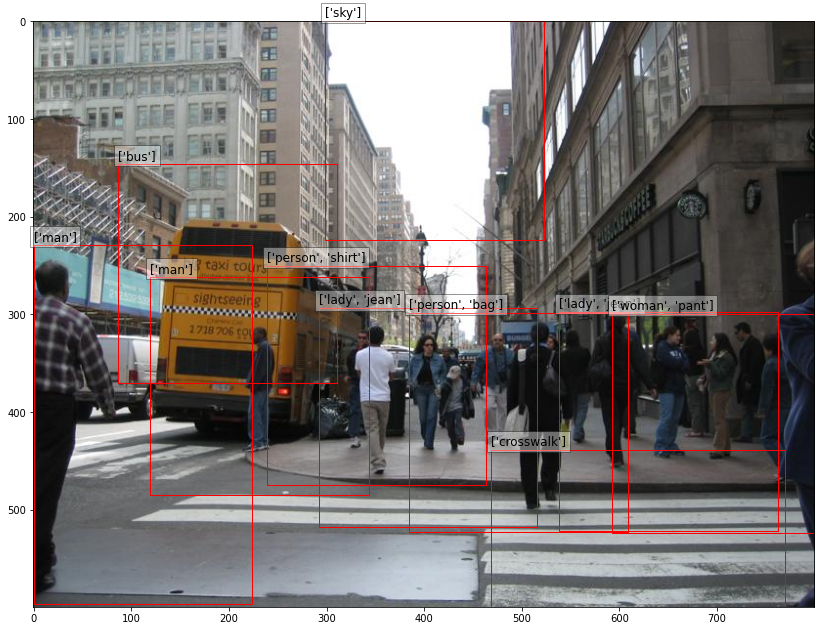

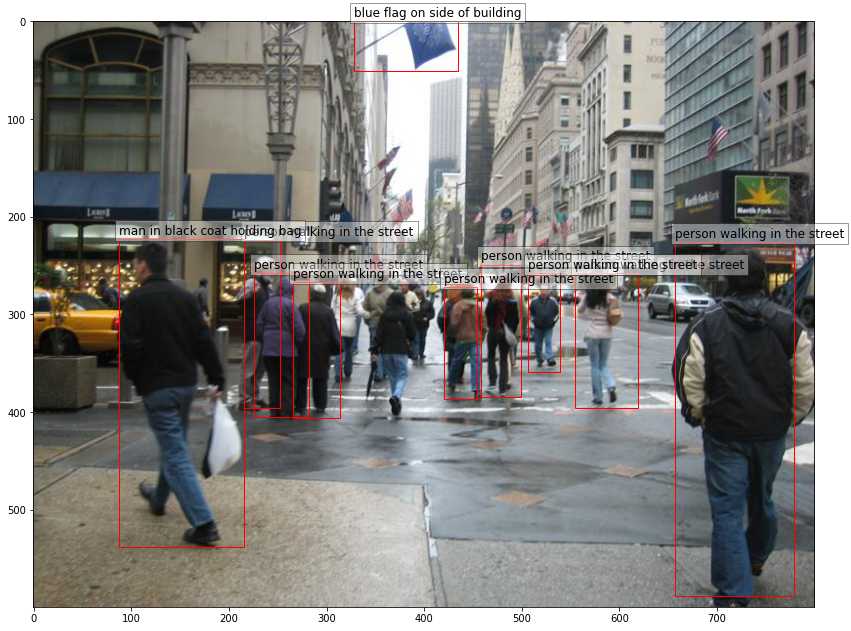

{'person': 0.004621483385562897, 'group person': 0.009046872146427631, 'umbrella person': 0.17569918930530548, 'bench person': 0.005170709453523159, 'camera person': 0.01117184292525053, 'sidewalk person': 0.7749196290969849}
{'sidewalk person': 0.7686959505081177}
{'street': 0.056572794914245605, 'way street': 0.10815518349409103, 'lane street': 0.06323067843914032, 'stone street': 0.08503410220146179, 'pavement street': 0.12989741563796997, 'downtown street': 0.31096765398979187}
{'way street': 0.325652152299881}
{'person': 0.004621483385562897, 'group person': 0.009046872146427631, 'umbrella person': 0.17569918930530548, 'bench person': 0.005170709453523159, 'camera person': 0.01117184292525053, 'sidewalk person': 0.7749196290969849}
{'sidewalk person': 0.7421631813049316}
{'street': 0.056572794914245605, 'way street': 0.10815518349409103, 'lane street': 0.06323067843914032, 'stone street': 0.08503410220146179, 'pavement street': 0.12989741563796997, 'downtown street': 0.31096765398

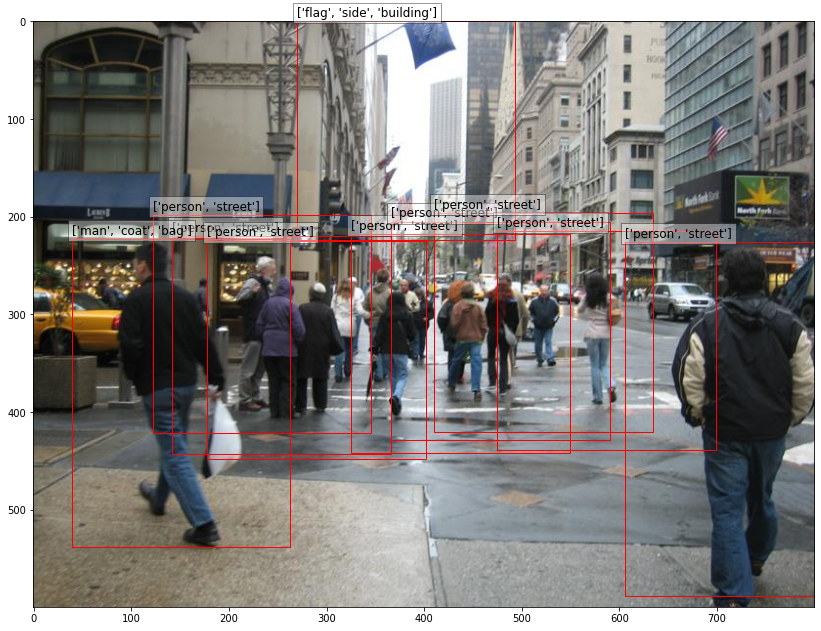

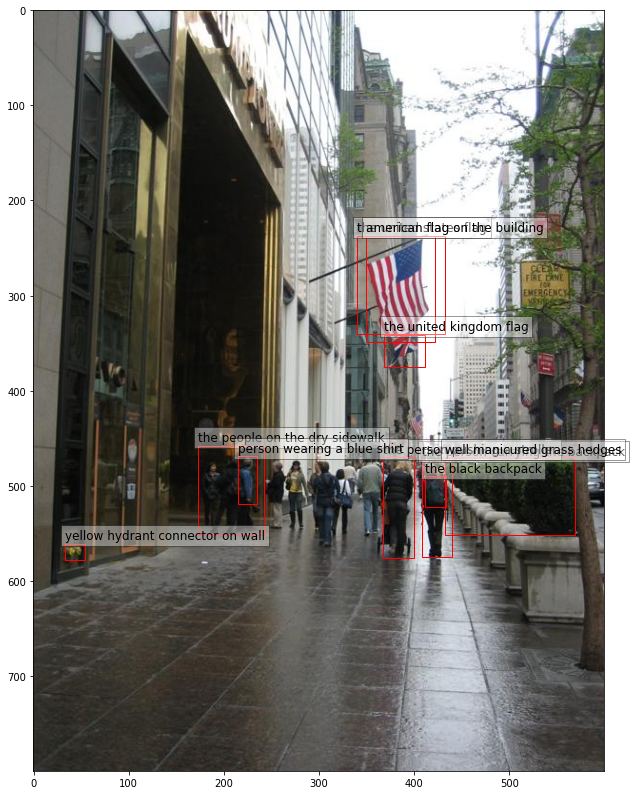

{'state flag': 1.0}
{'state flag': 1.0}
{'backpack': 1.0}
{'backpack': 1.0}
{'person': 0.004280370194464922, 'umbrella person': 0.28634515404701233, 'camera person': 0.006883219815790653, 'sidewalk person': 0.6705450415611267, 'coat person': 0.0062338500283658504}
{'sidewalk person': 0.9084072709083557}
{'backpack': 1.0}
{'backpack': 1.0}
{'person': 0.004280370194464922, 'umbrella person': 0.28634515404701233, 'camera person': 0.006883219815790653, 'sidewalk person': 0.6705450415611267, 'coat person': 0.0062338500283658504}
{'sidewalk person': 0.8874847292900085}
{'stroller': 0.8566836714744568}
{'stroller': 1.0}
{'person': 0.004280370194464922, 'umbrella person': 0.28634515404701233, 'camera person': 0.006883219815790653, 'sidewalk person': 0.6705450415611267, 'coat person': 0.0062338500283658504}
{'umbrella person': 0.7777804732322693}
{'sidewalk': 0.3664378225803375}
{'sidewalk': 1.0}
{'wall': 0.012494813650846481, 'building wall': 0.024021461606025696, 'glass wall': 0.0413837507367

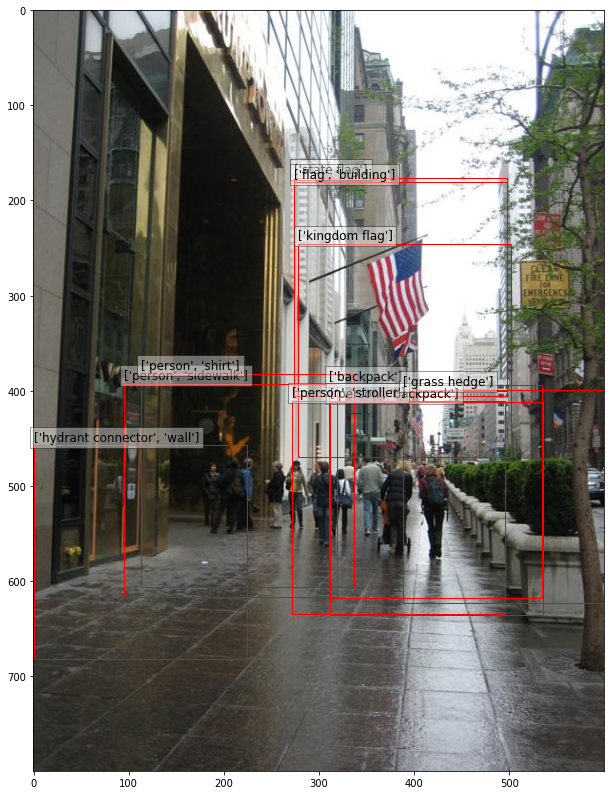

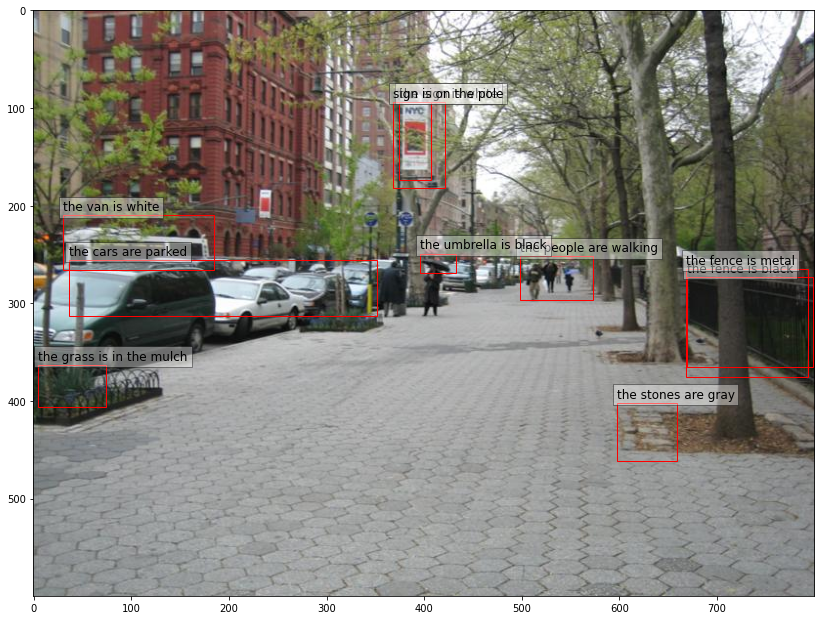

{'stone': 0.003639597212895751, 'cobblestone': 0.9769008159637451, 'pizza stone': 0.004291594494134188, 'brick stone': 0.010659202933311462}
{'cobblestone': 0.983672559261322}
{'car': 0.04457933455705643, 'police car': 0.11291997879743576, 'street car': 0.25780653953552246, 'cop car': 0.10981381684541702, 'taxi car': 0.07313363254070282, 'town car': 0.09309694916009903}
{'police car': 0.34445610642433167}
{'person': 0.006884326227009296, 'umbrella person': 0.018648086115717888, 'bench person': 0.04562191292643547, 'camera person': 0.0068022203631699085, 'sidewalk person': 0.8940105438232422, 'skateboard person': 0.010986506007611752}
{'sidewalk person': 0.8633962869644165}
{'fence': 0.012513509951531887, 'iron fence': 0.08862519264221191, 'chain-link fence': 0.015939630568027496, 'stone fence': 0.026491884142160416, 'steel fence': 0.019607145339250565, 'rail fence': 0.03809646889567375, 'brick fence': 0.054570719599723816, 'post fence': 0.03816315904259682, 'barrier fence': 0.025201655

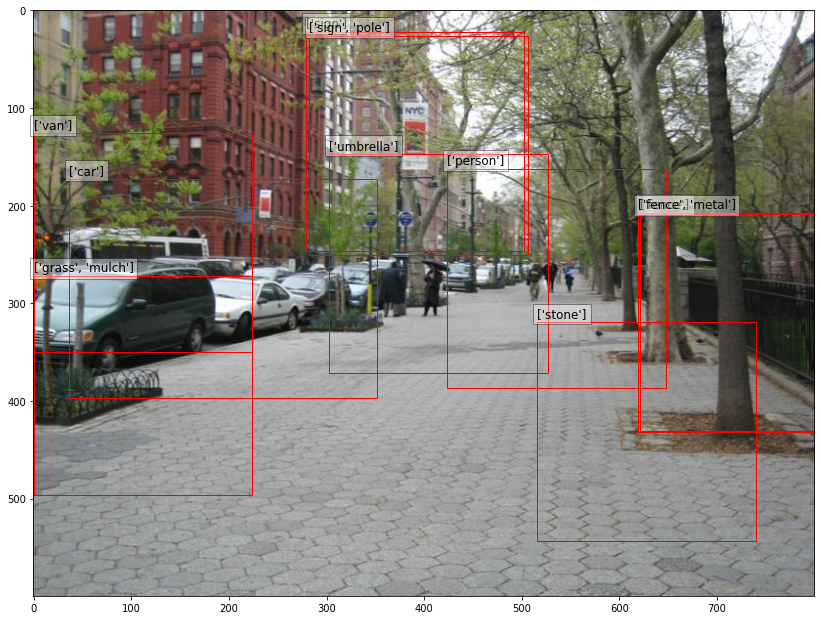

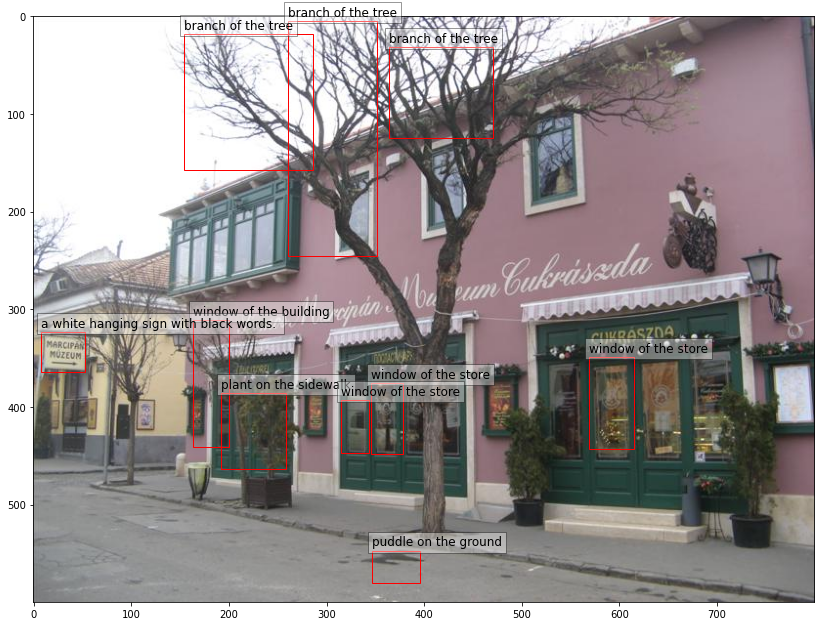

{'branch': 0.5342691540718079}
{'branch': 1.0}
{'tree': 0.023609686642885208, 'bare tree': 0.03243856132030487, 'shade tree': 0.026624443009495735, 'apple tree': 0.026766294613480568, 'willow tree': 0.07671243697404861, 'oak tree': 0.03569184988737106, 'cherry tree': 0.15040263533592224, 'fruit tree': 0.04609820991754532, 'size tree': 0.04379488155245781, 'lemon tree': 0.04980888590216637, 'round tree': 0.047555625438690186, 'cedar tree': 0.02582225389778614, 'bunch tree': 0.03981246426701546, 'brow tree': 0.13383084535598755, 'holiday tree': 0.028016991913318634}
{'bare tree': 0.4011499583721161}
{'branch': 0.5342691540718079}
{'branch': 1.0}
{'tree': 0.023609686642885208, 'bare tree': 0.03243856132030487, 'shade tree': 0.026624443009495735, 'apple tree': 0.026766294613480568, 'willow tree': 0.07671243697404861, 'oak tree': 0.03569184988737106, 'cherry tree': 0.15040263533592224, 'fruit tree': 0.04609820991754532, 'size tree': 0.04379488155245781, 'lemon tree': 0.04980888590216637, 'r

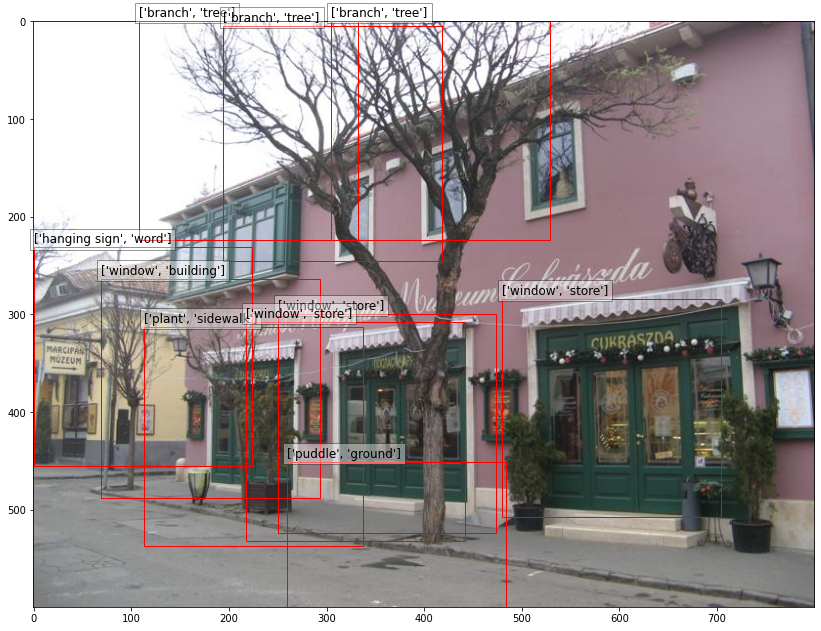

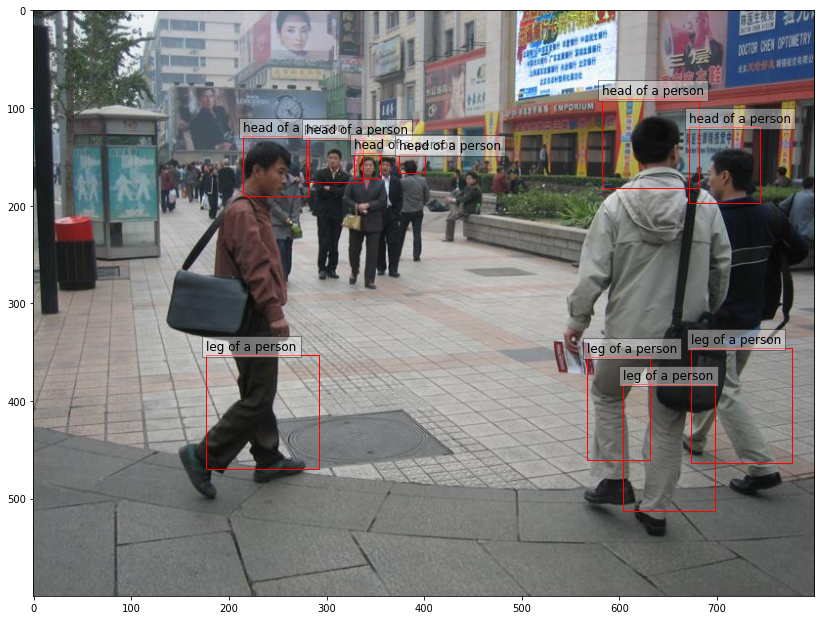

{'head': 0.07265415787696838, 'lady head': 0.087313711643219, 'train head': 0.1029469445347786, 'guy head': 0.09706368297338486, 'someone head': 0.19946910440921783, 'kid head': 0.08837015181779861}
{'train head': 0.4143943190574646}
{'person': 0.004328657872974873, 'pant person': 0.004898149520158768, 'group person': 0.007780127227306366, 'umbrella person': 0.07673607766628265, 'bench person': 0.010196555405855179, 'camera person': 0.04605066776275635, 'sidewalk person': 0.7861776351928711, 'skateboard person': 0.009401636198163033, 'bag person': 0.030638787895441055, 'focus person': 0.0043783546425402164}
{'camera person': 0.40325602889060974}
{'head': 0.07265415787696838, 'lady head': 0.087313711643219, 'train head': 0.1029469445347786, 'guy head': 0.09706368297338486, 'someone head': 0.19946910440921783, 'kid head': 0.08837015181779861}
{'someone head': 0.43761956691741943}
{'person': 0.004328657872974873, 'pant person': 0.004898149520158768, 'group person': 0.007780127227306366, '

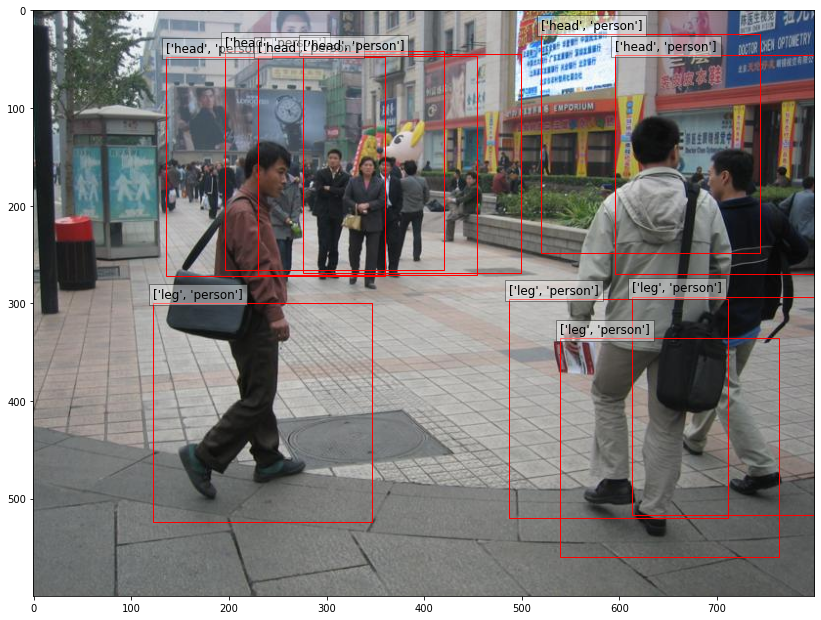

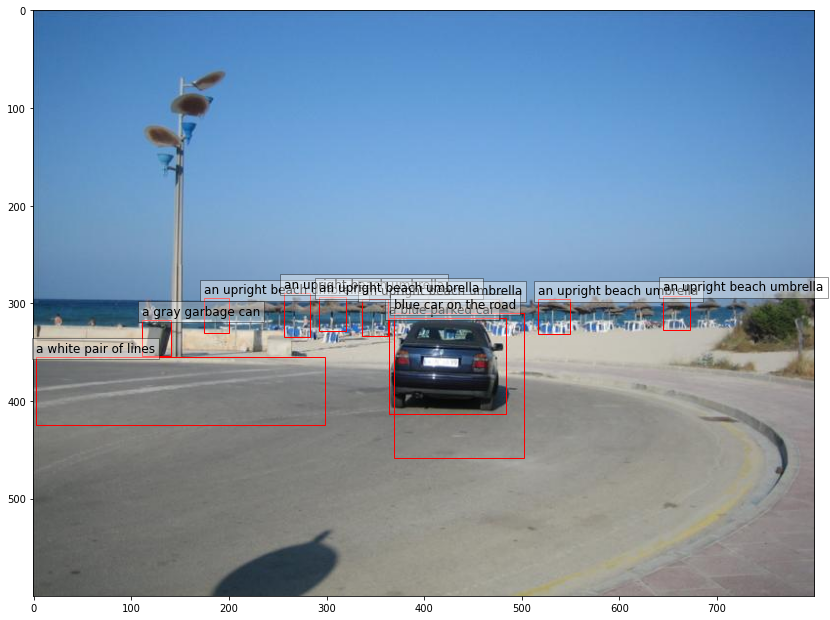

{'car': 0.14311063289642334, 'town car': 0.21628357470035553}
{'town car': 0.6229124069213867}
{'garbage': 0.8838648200035095}
{'garbage': 1.0}
{'pair': 1.0}
{'pair': 1.0}
{'line': 0.00038443683297373354, 'shoreline': 0.02491329237818718, 'tree line': 0.0007949476130306721, 'skyline': 0.004385813605040312, 'baseline': 0.0016650005709379911, 'boundary line': 0.0006546423537656665, 'horizon line': 0.008958431892096996, 'water line': 0.0016496818279847503, 'coastline': 0.015436709858477116, 'traffic line': 0.015199996531009674, 'crosswalk line': 0.0032187614124268293, 'street line': 0.0023961151018738747, 'safety line': 0.0022755060344934464, 'parking line': 0.6052469611167908, 'dash line': 0.001711988472379744, 'road line': 0.008325130678713322, 'cable line': 0.0003241706872358918, 'roof line': 0.0017705662176012993, 'rail line': 0.00045008445158600807, 'city sky line': 0.002377445576712489, 'tennis court line': 0.002220414811745286, 'lane line': 0.0039130523800849915, 'parking space lin

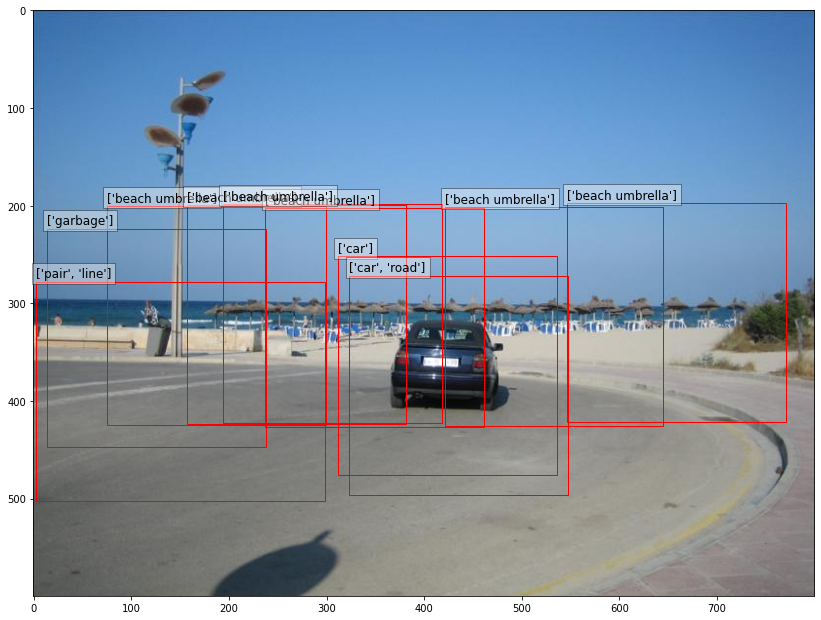

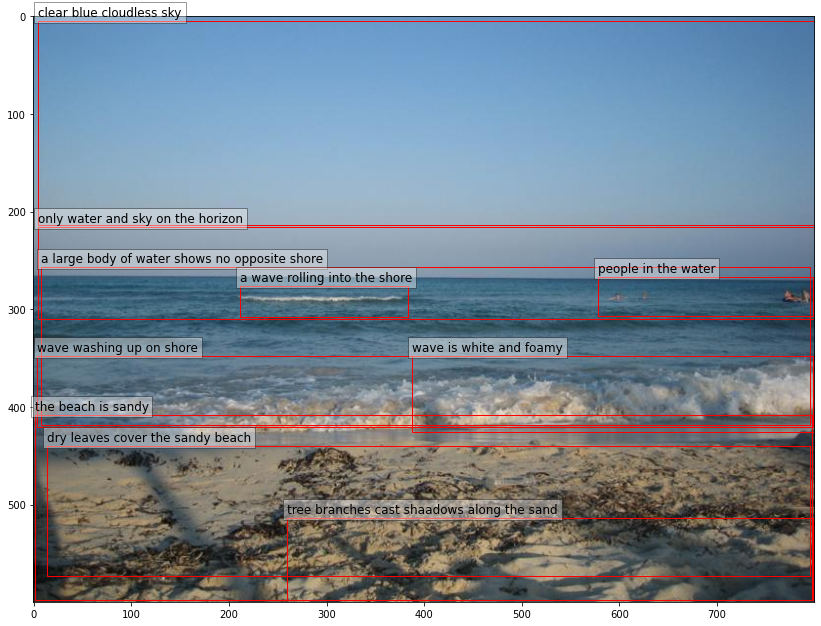

{'tree branch': 1.0}
{'tree branch': 1.0}
{'sand': 0.2943873405456543, 'water sand': 0.5000205039978027}
{'water sand': 0.5324797630310059}
{'beach': 0.4202216863632202}
{'beach': 1.0}
{'leaf': 0.052099134773015976, 'palm leaf': 0.40498360991477966, 'palm tree leaf': 0.25944891571998596, 'pine leaf': 0.09702297300100327}
{'pine leaf': 0.42631158232688904}
{'beach': 0.4202216863632202}
{'beach': 1.0}
{'wave': 0.10909252613782883, 'beach wave': 0.38895708322525024}
{'beach wave': 0.8842063546180725}
{'shore': 0.10692726820707321, 'sea shore': 0.32216402888298035, 'beach shore': 0.33271950483322144, 'ocean shore': 0.1283697634935379}
{'beach shore': 0.28749337792396545}
{'person': 0.4311330318450928}
{'person': 1.0}
{'water': 0.017385922372341156, 'ocean water': 0.0886831283569336, 'sea water': 0.16072627902030945, 'body water': 0.022690745070576668, 'beach water': 0.44459450244903564, 'wavy water': 0.031210850924253464, 'salt water': 0.08538363873958588, 'wave water': 0.10268700867891312

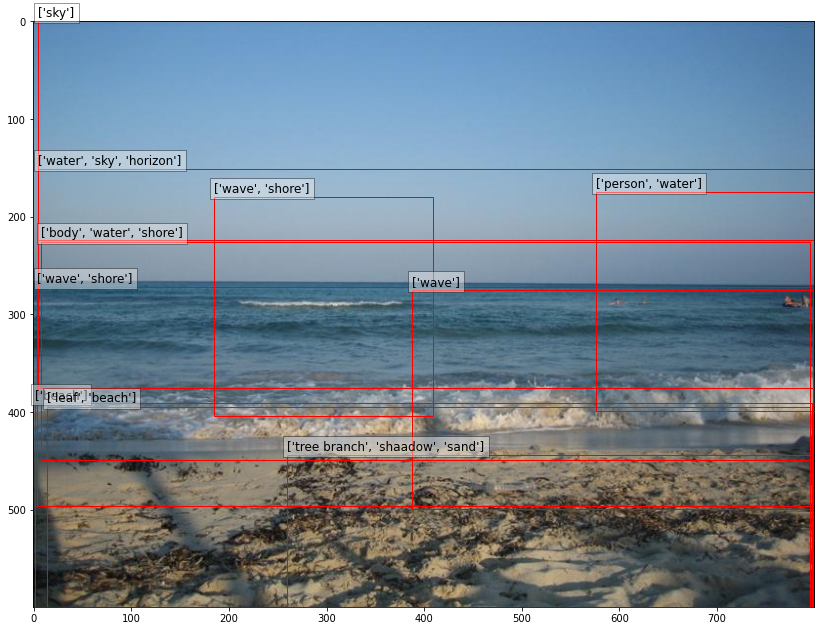

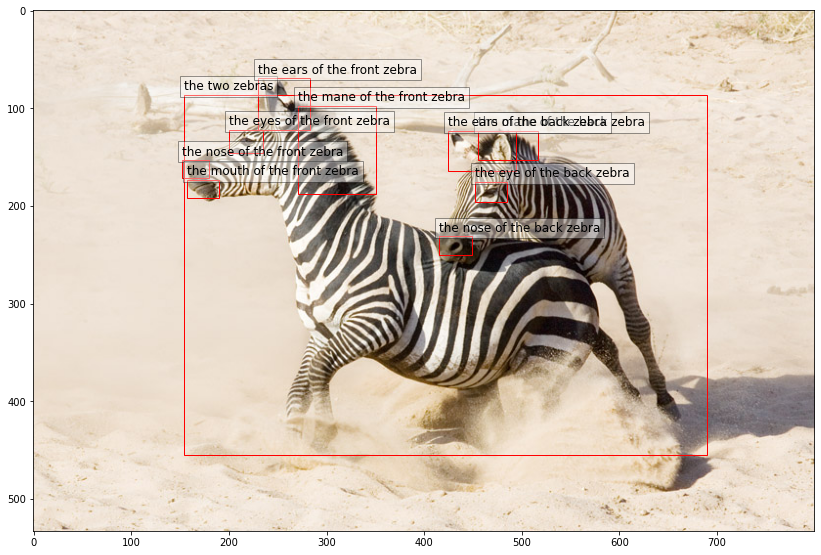

{'zebra': 0.3921944797039032, 'adult zebra': 0.48346585035324097}
{'adult zebra': 0.5938366055488586}
{'mane': 0.005049692466855049, 'zebra mane': 0.9891505837440491, 'giraffe mane': 0.005655139219015837}
{'zebra mane': 0.9850762486457825}
{'zebra': 0.3921944797039032, 'adult zebra': 0.48346585035324097}
{'adult zebra': 0.5936248898506165}
{'mane': 0.005049692466855049, 'zebra mane': 0.9891505837440491, 'giraffe mane': 0.005655139219015837}
{'zebra mane': 0.9854215383529663}
{'zebra': 0.3921944797039032, 'adult zebra': 0.48346585035324097}
{'adult zebra': 0.6475300788879395}
{'ear': 0.28346574306488037, 'animal ear': 0.6917740106582642}
{'animal ear': 0.7731223702430725}
{'zebra': 0.3921944797039032, 'adult zebra': 0.48346585035324097}
{'adult zebra': 0.7000732421875}
{'eye': 0.0005004066624678671, 'elephant eye': 0.00211834697984159, 'giraffe eye': 0.002108517102897167, 'animal eye': 0.0012935161357745528, 'baby eye': 0.00046124376240186393, 'bull eye': 0.0008214470581151545, 'zebras 

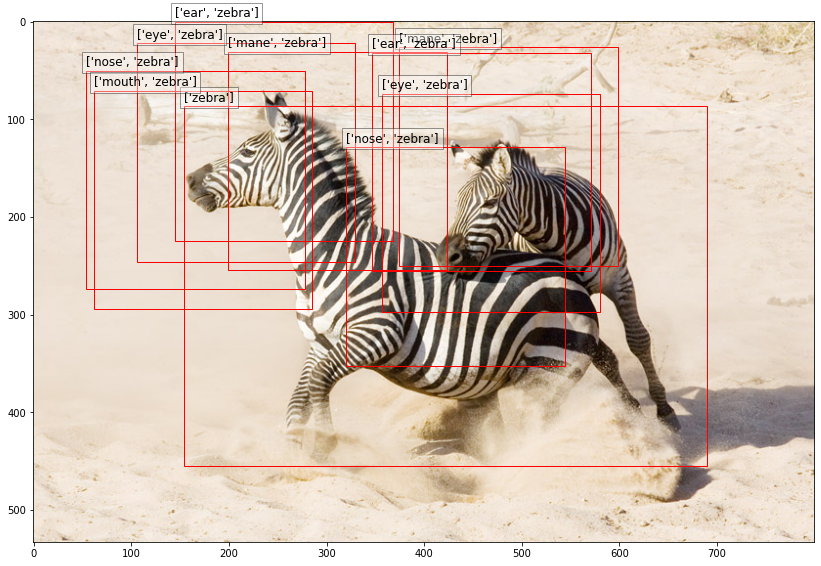

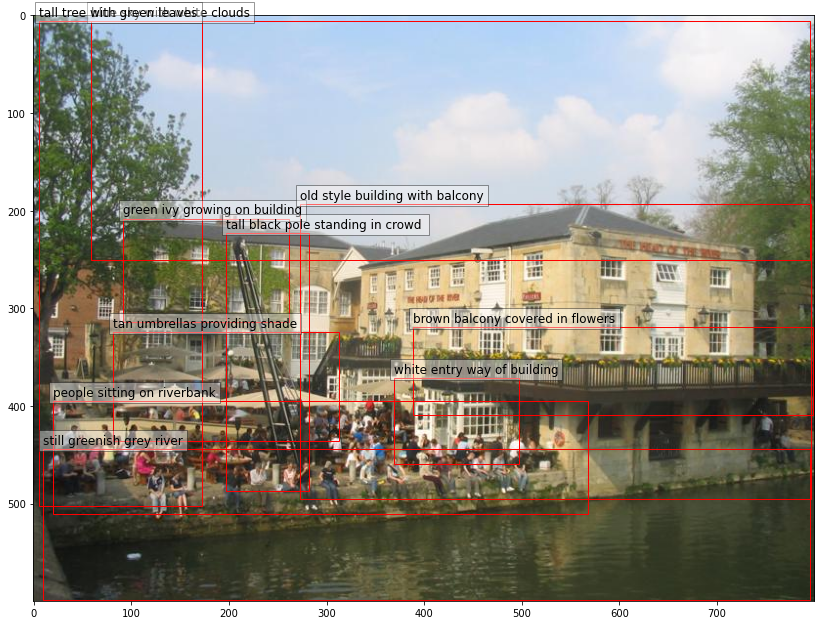

{'ivy': 1.0}
{'ivy': 1.0}
{'building': 0.0494336299598217, 'stone building': 0.05890369787812233, 'hotel building': 0.06810666620731354, 'block building': 0.05097112059593201, 'clock building': 0.07762256264686584, 'age building': 0.06845203787088394, 'clock tower building': 0.07725986838340759, 'castle building': 0.06463903188705444}
{'hotel building': 0.39626237750053406}
{'balcony': 0.3012367784976959}
{'balcony': 1.0}
{'river': 1.0}
{'river': 1.0}
{'person': 0.2048282027244568}
{'person': 1.0}
{'riverbank': 1.0}
{'riverbank': 1.0}
{'shade': 0.43857714533805847}
{'shade': 1.0}
{'pole': 0.049503687769174576, 'iron pole': 0.055425163358449936, 'sail pole': 0.14788179099559784}
{'pole': 0.3623493015766144}
{'crowd': 1.0}
{'crowd': 1.0}
{'balcony': 0.3012367784976959}
{'balcony': 1.0}
{'flower': 0.5307257175445557}
{'flower': 1.0}
{'sky': 0.06675028800964355, 'daytime sky': 0.1176375225186348, 'afternoon sky': 0.10836625099182129, 'summer sky': 0.23360970616340637, 'blye sky': 0.1030991

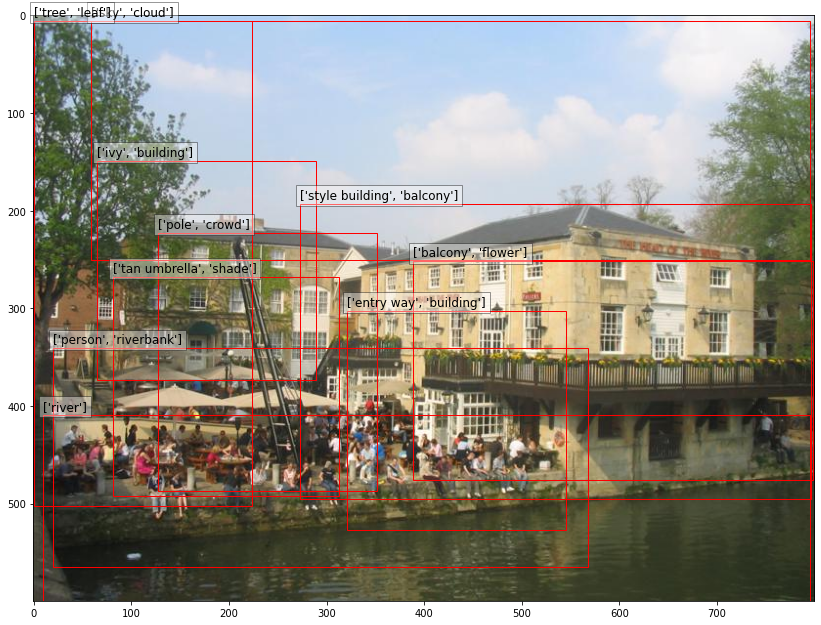

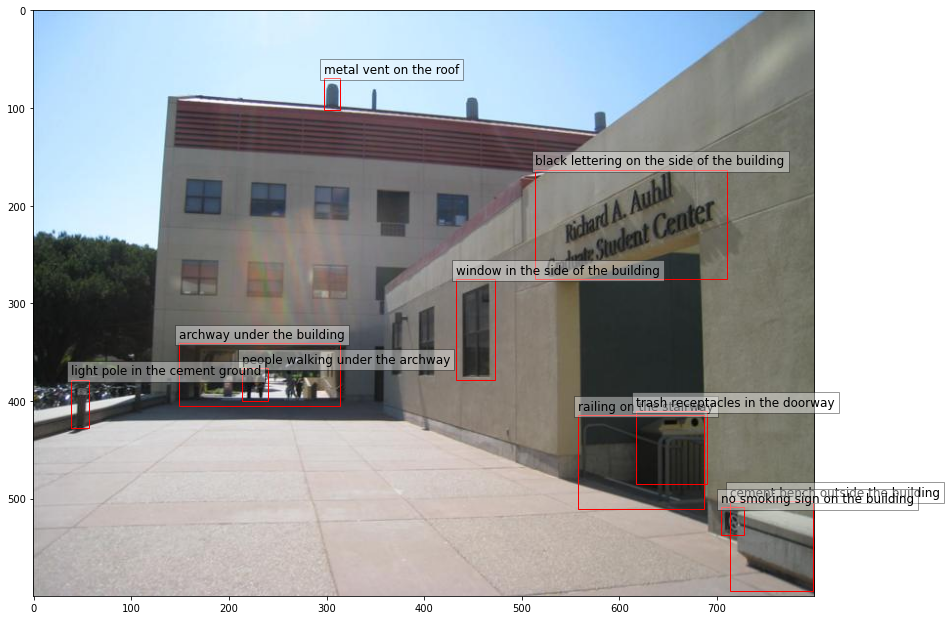

{'cement bench': 1.0}
{'cement bench': 1.0}
{'building': 0.003840421326458454, 'brick building': 0.01566091738641262, 'stone building': 0.006618841551244259, 'city building': 0.004392746835947037, 'story building': 0.027642227709293365, 'office building': 0.01359422318637371, 'multistory building': 0.006510566920042038, 'church building': 0.008440700359642506, 'airport building': 0.022857563570141792, 'metal building': 0.029294155538082123, 'cement building': 0.029509978368878365, 'roof building': 0.004912685602903366, 'story brick building': 0.02147172950208187, 'wood building': 0.00989475380629301, 'block building': 0.03571300208568573, 'business building': 0.024365998804569244, 'window building': 0.011210866272449493, 'stucco building': 0.014435909688472748, 'level building': 0.03084580786526203, 'rock building': 0.00495878653600812, 'government building': 0.017787352204322815, 'floor building': 0.02073209546506405, 'airport terminal building': 0.004303032997995615, 'bank building':

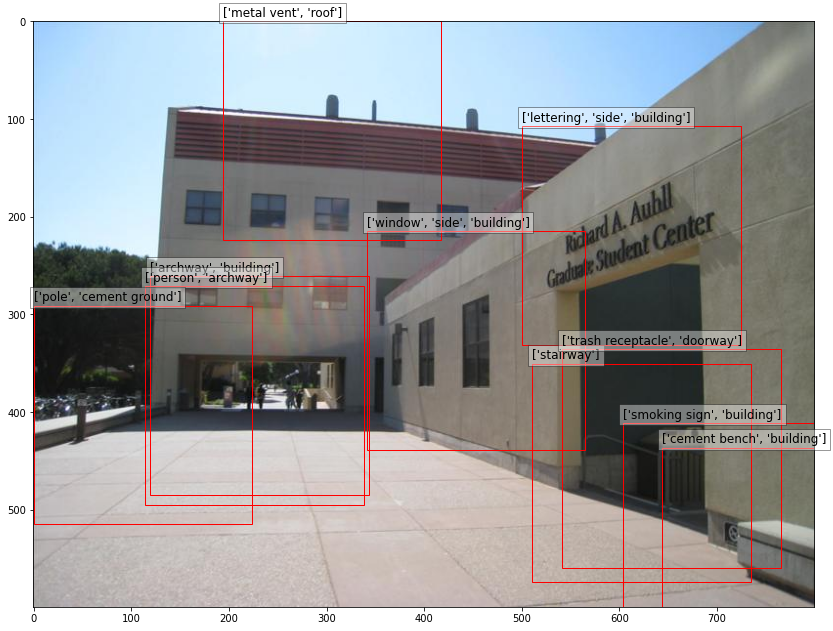

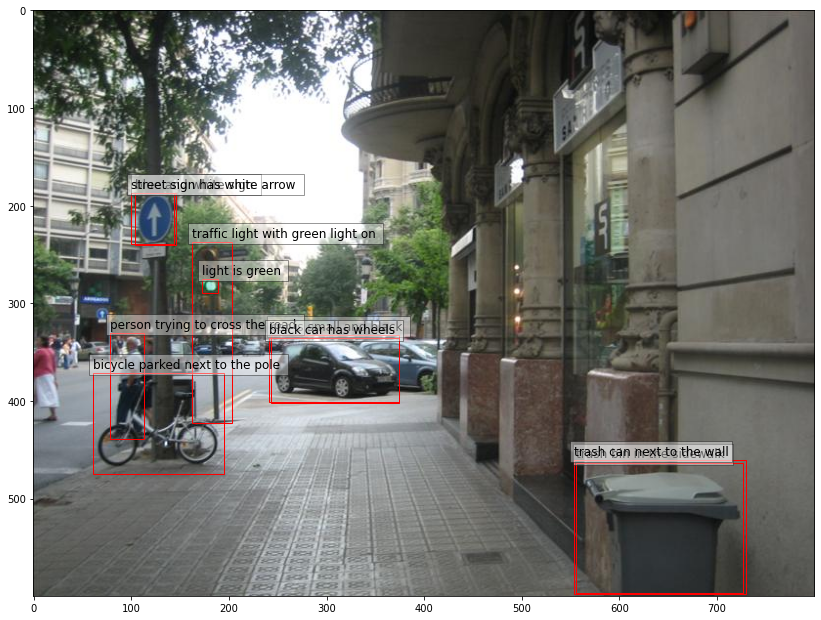

{'sign': 0.003287113271653652, 'street sign': 0.05547120049595833, 'traffic sign': 0.008370626717805862, 'parking sign': 0.006974731106311083, 'way sign': 0.00624768016859889, 'speed limit sign': 0.01431816816329956, 'street name sign': 0.017964093014597893, 'walk sign': 0.013127815909683704, 'stop sign': 0.008014945313334465, 'bus stop sign': 0.019763443619012833, 'u-turn sign': 0.020755864679813385, 'crosswalk sign': 0.01013252604752779, 'direction sign': 0.004010567907243967, 'way street sign': 0.03956326097249985, 'bus sign': 0.006019564811140299, 'destination sign': 0.004006190691143274, 'pedestrian sign': 0.029497135430574417, 'bus destination sign': 0.0038296596612781286, 'pedestrian crossing sign': 0.023458926007151604, 'building sign': 0.003331139450892806, 'hotel sign': 0.0038282794412225485, 'way traffic sign': 0.006293126847594976, 'bicycle sign': 0.0034786013420671225, 'taxi sign': 0.004915804602205753, 'bank sign': 0.02348070591688156, 'traffic stop sign': 0.0081346277147

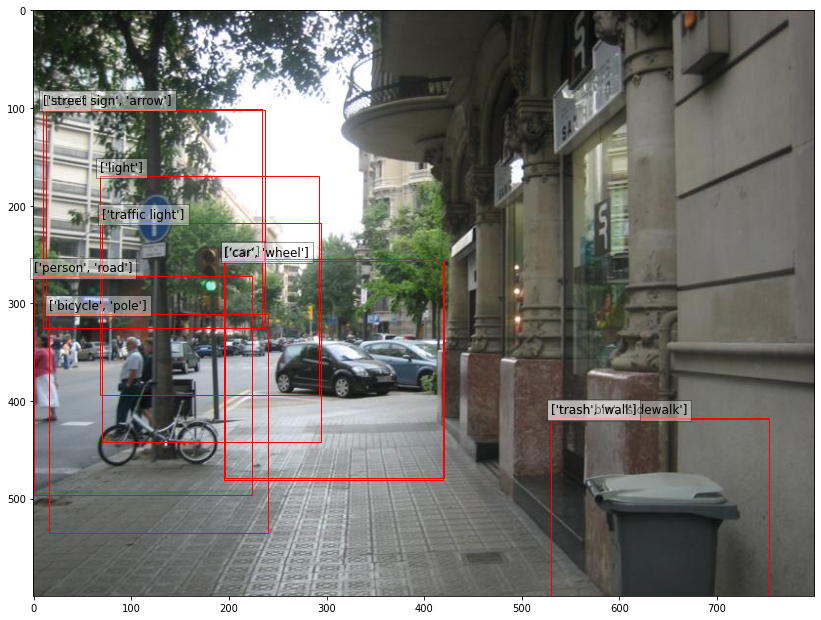

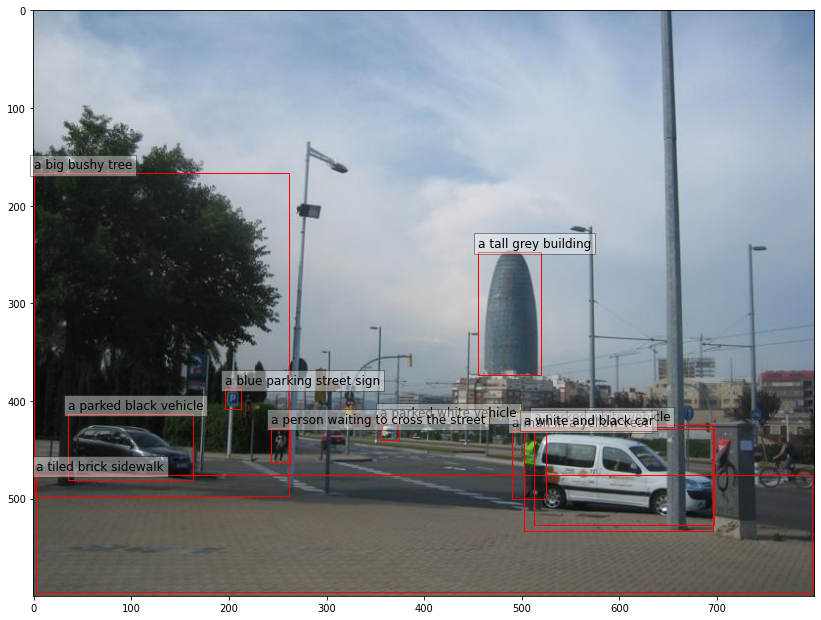

{'vehicle': 0.11385781317949295, 'police vehicle': 0.12607358396053314, 'service vehicle': 0.16106368601322174, 'transportation vehicle': 0.1289692223072052}
{'service vehicle': 0.618207573890686}
{'vehicle': 0.11385781317949295, 'police vehicle': 0.12607358396053314, 'service vehicle': 0.16106368601322174, 'transportation vehicle': 0.1289692223072052}
{'vehicle': 0.41418296098709106}
{'vest': 0.12631258368492126, 'security vest': 0.485977441072464}
{'security vest': 0.9402999877929688}
{'building': 0.004048526287078857, 'city building': 0.031746432185173035, 'office building': 0.030808746814727783, 'glass building': 0.013375557027757168, 'highrise building': 0.06637290865182877, 'rise building': 0.03339897468686104, 'airport building': 0.013530384749174118, 'cement building': 0.0071752299554646015, 'skyscraper building': 0.048249252140522, 'hotel building': 0.007350143510848284, 'block building': 0.005114006344228983, 'business building': 0.0073880297131836414, 'capitol building': 0.0

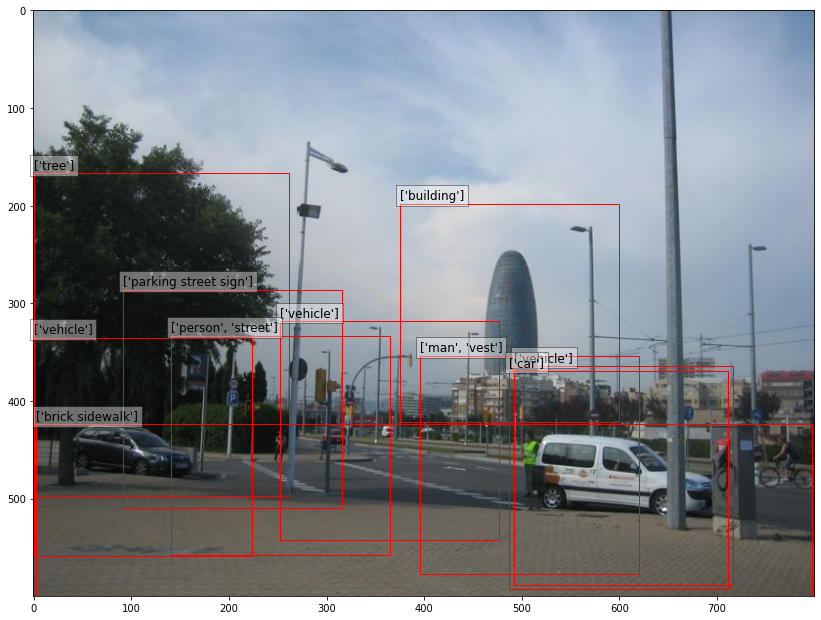

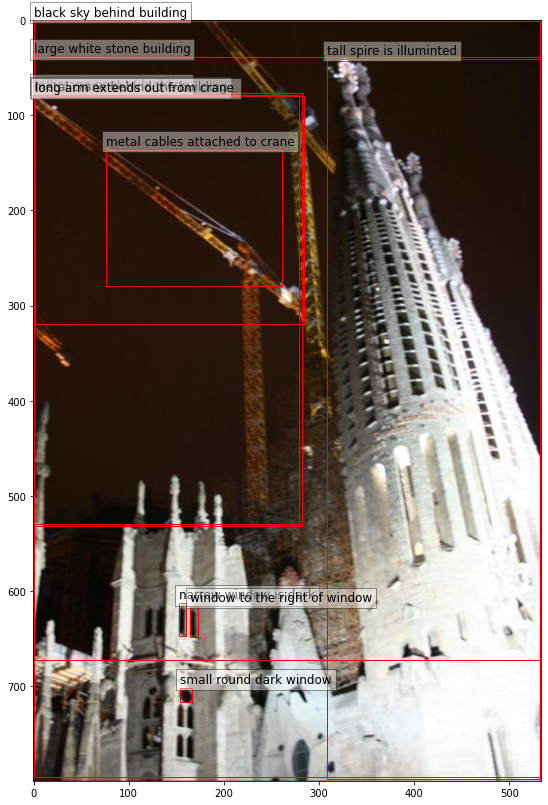

{'crane': 0.28667494654655457, 'construction crane': 0.655433714389801}
{'crane': 0.5736760497093201}
{'building': 0.014748665504157543, 'city building': 0.02817218191921711, 'glass building': 0.015859130769968033, 'highrise building': 0.0456676110625267, 'rise building': 0.043258462101221085, 'skyscraper building': 0.028362831100821495, 'block building': 0.059206247329711914, 'level building': 0.022572118788957596, 'tower building': 0.3517741858959198, 'rock building': 0.021814582869410515, 'floor building': 0.021744711324572563, 'wall building': 0.029526671394705772, 'marble building': 0.020541546866297722, 'buildinga building': 0.027004288509488106, 'castle building': 0.0617486834526062}
{'block building': 0.16735821962356567}
{'sky': 0.08962047845125198, 'night sky': 0.1185087189078331, 'evening sky': 0.0904117077589035, 'snow sky': 0.14405031502246857, 'night time sky': 0.1341080218553543}
{'snow sky': 0.2577211856842041}
{'building': 0.014748665504157543, 'city building': 0.02817

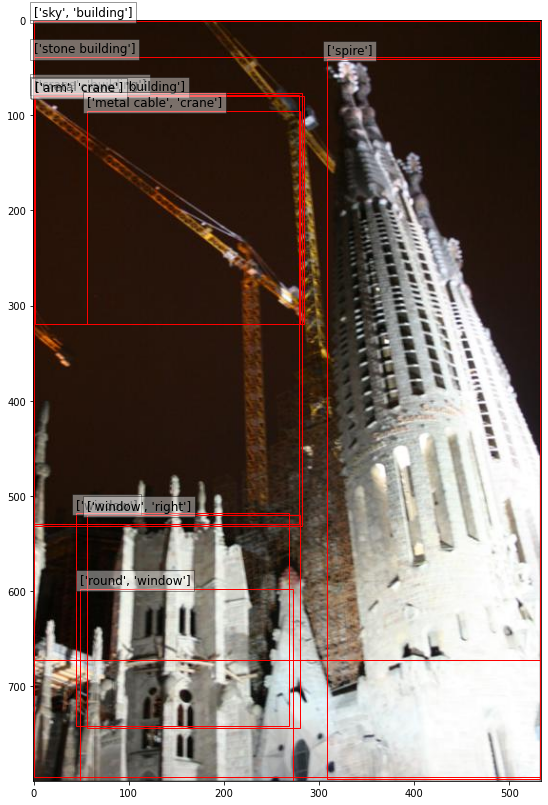

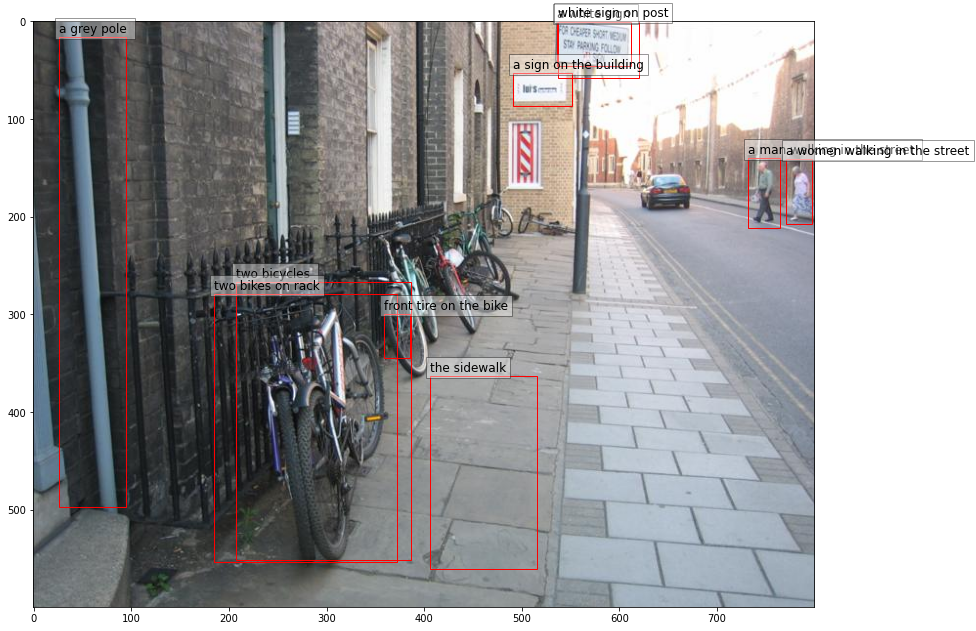

{'bicycle': 0.37926551699638367, 'metal bicycle': 0.501392126083374}
{'metal bicycle': 0.7627993822097778}
{'pole': 0.015321002341806889, 'metal pole': 0.029708441346883774, 'street pole': 0.17479963600635529, 'steel pole': 0.02152315527200699, 'support pole': 0.02803245559334755, 'traffic pole': 0.03634802997112274, 'street light pole': 0.025797851383686066, 'iron pole': 0.1157212033867836, 'metal support pole': 0.020805127918720245, 'metal street pole': 0.04015034809708595, 'safety pole': 0.05097108706831932, 'barrier pole': 0.04643821716308594, 'phone pole': 0.07322400063276291, 'parking meter pole': 0.0236419215798378, 'streetlight pole': 0.02762492001056671, 'telegram pole': 0.01596640981733799, 'metal railing pole': 0.018406745046377182}
{'metal railing pole': 0.5222694873809814}
{'sidewalk': 0.2917908728122711}
{'sidewalk': 1.0}
{'tire': 0.02400771714746952, 'bike tire': 0.18752813339233398, 'bicycle tire': 0.32446667551994324, 'wall tire': 0.04889286309480667, 'fron tire': 0.14

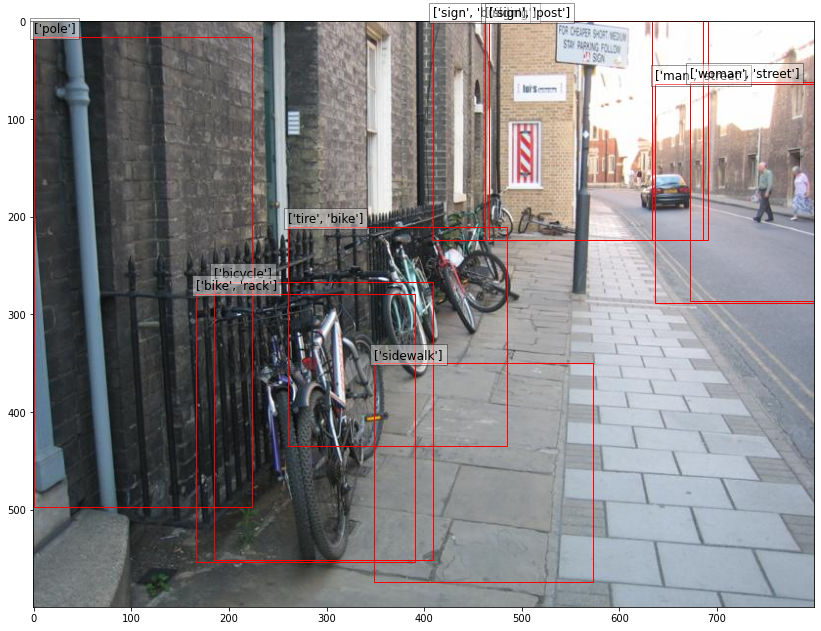

In [18]:
for i in range(120, 140):
    ex = regions[i]
    plot_img_from_region(d=ex)
    plot_img_from_region(d=ex, pos=True, subs=True)

In [17]:
object2subtypes['hat']

{'baseball hat': 795,
 'cowboy hat': 759,
 'straw hat': 530,
 'hat': 400,
 'winter hat': 221,
 'santa hat': 220,
 'fireman hat': 200,
 'visor hat': 200,
 'police hat': 200,
 'party hat': 101,
 'sun hat': 97,
 'ski hat': 93,
 'bucket hat': 82,
 'chef hat': 82,
 'birthday hat': 79,
 'beanie hat': 67,
 'christmas hat': 57,
 'paper hat': 45,
 'umbrella hat': 45,
 'fedora hat': 40,
 'camouflage hat': 30,
 'fur hat': 29,
 'sock hat': 27,
 'plaid hat': 26,
 'pirate hat': 22,
 'base ball hat': 17,
 'cloth hat': 17,
 'leather hat': 17,
 'construction hat': 16,
 'balloon hat': 16,
 'tennis hat': 14,
 'straw cowboy hat': 13,
 'safari hat': 13,
 'wicker hat': 12,
 'cow boy hat': 12,
 'dress hat': 11,
 'fishing hat': 11,
 'panama hat': 11,
 'safety hat': 11,
 'trucker hat': 11,
 'nike hat': 11,
 'panda hat': 10,
 'crochet hat': 10,
 'graduation hat': 10,
 'turban hat': 10}